In [1]:
import cv2
import numpy as np
import random
from pathlib import Path
import torch
import torch.nn as nn
import torch.optim as optim
import torch.nn.functional as F
from pathlib import Path
from PIL import Image
from torch.utils.data import Dataset, DataLoader, random_split
import torchvision.transforms as transforms
import matplotlib.pyplot as plt

In [2]:
# Đường dẫn ảnh gốc và ảnh hỏng
input_dir = Path("/kaggle/input/fakefaces")
output_dir = Path("/kaggle/working/fakefaces_degraded")
output_dir.mkdir(parents=True, exist_ok=True)

# Hàm thêm nhiễu Gaussian
def add_gaussian_noise(image, mean=0, sigma=25):
    noise = np.random.normal(mean, sigma, image.shape).astype(np.uint8)
    noisy_image = cv2.add(image, noise)
    return noisy_image

# Hàm làm biến dạng màu
def distort_colors(image):
    hsv = cv2.cvtColor(image, cv2.COLOR_BGR2HSV).astype(np.float32)
    hsv[:, :, 1] *= random.uniform(0.3, 0.7)  # giảm saturation
    hsv[:, :, 2] *= random.uniform(0.6, 1.2)  # thay đổi brightness
    hsv = np.clip(hsv, 0, 255).astype(np.uint8)
    distorted = cv2.cvtColor(hsv, cv2.COLOR_HSV2BGR)
    return distorted

# Hàm tạo vùng rách, mất mảng bất quy tắc
def occlude_irregular(image, num_shapes=3):
    h, w = image.shape[:2]
    for _ in range(num_shapes):
        num_points = random.randint(6, 10)
        center_x = random.randint(200, w - 200)
        center_y = random.randint(200, h - 200)
        max_offset = random.randint(80, 200)

        points = []
        for _ in range(num_points):
            dx = random.randint(-max_offset, max_offset)
            dy = random.randint(-max_offset, max_offset)
            points.append([center_x + dx, center_y + dy])

        polygon = np.array([points], dtype=np.int32)
        r = random.random()
        if r < 0.33:
            cv2.fillPoly(image, polygon, (0, 0, 0))
        elif r < 0.66:
            cv2.fillPoly(image, polygon, (255, 255, 255))
        else:
            mask = np.zeros_like(image)
            noise = np.random.randint(0, 256, image.shape, dtype=np.uint8)
            cv2.fillPoly(mask, polygon, (255, 255, 255))
            image = np.where(mask == 255, noise, image)
    return image

# === Duyệt qua ảnh gốc và tạo ảnh hỏng ===
for img_path in input_dir.glob("*.jpg"):
    img = cv2.imread(str(img_path))

    # Tạo 3 biến thể hỏng
    noisy = add_gaussian_noise(img.copy())
    color_distorted = distort_colors(img.copy())
    occluded = occlude_irregular(img.copy())

    # Lưu ảnh hỏng với hậu tố tương ứng
    cv2.imwrite(str(output_dir / f"{img_path.stem}_noisy.jpg"), noisy)
    cv2.imwrite(str(output_dir / f"{img_path.stem}_color.jpg"), color_distorted)
    cv2.imwrite(str(output_dir / f"{img_path.stem}_occluded.jpg"), occluded)

print("Đã tạo ảnh hỏng")

Đã tạo ảnh hỏng


In [3]:
class FaceRestorationGANDataset(Dataset):
    def __init__(self, degraded_dir, original_dir, transform=None):
        self.degraded_dir = Path(degraded_dir)
        self.original_dir = Path(original_dir)
        self.transform = transform
        
        # Tạo danh sách các cặp ảnh
        self.image_pairs = []
        for original_path in sorted(self.original_dir.glob("*.jpg")):
            img_name = original_path.stem
            # Tìm tất cả ảnh hỏng tương ứng
            for suffix in ['_noisy.jpg', '_color.jpg', '_occluded.jpg']:
                degraded_path = self.degraded_dir / f"{img_name}{suffix}"
                if degraded_path.exists():
                    self.image_pairs.append((degraded_path, original_path))
    
    def __len__(self):
        return len(self.image_pairs)
    
    def __getitem__(self, idx):
        degraded_path, original_path = self.image_pairs[idx]
        
        # Load ảnh
        degraded_img = Image.open(degraded_path).convert('RGB')
        original_img = Image.open(original_path).convert('RGB')
        
        if self.transform:
            degraded_img = self.transform(degraded_img)
            original_img = self.transform(original_img)
        
        return degraded_img, original_img

In [4]:
class UNetBlock(nn.Module):
    """U-Net building block"""
    def __init__(self, in_channels, out_channels, down=True, use_dropout=False):
        super(UNetBlock, self).__init__()
        if down:
            self.conv = nn.Conv2d(in_channels, out_channels, 4, stride=2, padding=1, bias=False)
        else:
            self.conv = nn.ConvTranspose2d(in_channels, out_channels, 4, stride=2, padding=1, bias=False)
            
        self.norm = nn.BatchNorm2d(out_channels)
        self.relu = nn.ReLU(inplace=True) if down else nn.ReLU(inplace=True)
        self.dropout = nn.Dropout(0.5) if use_dropout else None
        self.leaky_relu = nn.LeakyReLU(0.2, inplace=True)
        self.down = down
    
    def forward(self, x):
        if self.down:
            x = self.conv(x)
            x = self.norm(x)
            x = self.leaky_relu(x)
        else:
            x = self.conv(x)
            x = self.norm(x)
            if self.dropout:
                x = self.dropout(x)
            x = self.relu(x)
        return x


In [5]:
class UNetGenerator(nn.Module):
    """U-Net Generator cho Face Restoration"""
    def __init__(self, in_channels=3, out_channels=3):
        super(UNetGenerator, self).__init__()
        
        # Encoder (Downsampling)
        self.down1 = nn.Conv2d(in_channels, 64, 4, stride=2, padding=1)  # 128x128
        self.down2 = UNetBlock(64, 128, down=True)      # 64x64
        self.down3 = UNetBlock(128, 256, down=True)     # 32x32
        self.down4 = UNetBlock(256, 512, down=True)     # 16x16
        self.down5 = UNetBlock(512, 512, down=True)     # 8x8
        self.down6 = UNetBlock(512, 512, down=True)     # 4x4
        self.down7 = UNetBlock(512, 512, down=True)     # 2x2
        self.down8 = UNetBlock(512, 512, down=True)     # 1x1
        
        # Decoder (Upsampling) with skip connections
        self.up1 = UNetBlock(512, 512, down=False, use_dropout=True)     # 2x2
        self.up2 = UNetBlock(1024, 512, down=False, use_dropout=True)    # 4x4
        self.up3 = UNetBlock(1024, 512, down=False, use_dropout=True)    # 8x8
        self.up4 = UNetBlock(1024, 512, down=False)                      # 16x16
        self.up5 = UNetBlock(1024, 256, down=False)                      # 32x32
        self.up6 = UNetBlock(512, 128, down=False)                       # 64x64
        self.up7 = UNetBlock(256, 64, down=False)                        # 128x128
        
        self.final = nn.ConvTranspose2d(128, out_channels, 4, stride=2, padding=1)  # 256x256
        self.tanh = nn.Tanh()
        self.leaky_relu = nn.LeakyReLU(0.2, inplace=True)
    
    def forward(self, x):
        # Encoder
        d1 = self.leaky_relu(self.down1(x))
        d2 = self.down2(d1)
        d3 = self.down3(d2)
        d4 = self.down4(d3)
        d5 = self.down5(d4)
        d6 = self.down6(d5)
        d7 = self.down7(d6)
        d8 = self.down8(d7)
        
        # Decoder with skip connections
        u1 = self.up1(d8)
        u2 = self.up2(torch.cat([u1, d7], 1))
        u3 = self.up3(torch.cat([u2, d6], 1))
        u4 = self.up4(torch.cat([u3, d5], 1))
        u5 = self.up5(torch.cat([u4, d4], 1))
        u6 = self.up6(torch.cat([u5, d3], 1))
        u7 = self.up7(torch.cat([u6, d2], 1))
        
        output = self.final(torch.cat([u7, d1], 1))
        return self.tanh(output)

In [6]:
class PatchGANDiscriminator(nn.Module):
    """PatchGAN Discriminator"""
    def __init__(self, in_channels=6):  # 6 = degraded + original
        super(PatchGANDiscriminator, self).__init__()
        
        def discriminator_block(in_filters, out_filters, normalize=True):
            layers = [nn.Conv2d(in_filters, out_filters, 4, stride=2, padding=1)]
            if normalize:
                layers.append(nn.BatchNorm2d(out_filters))
            layers.append(nn.LeakyReLU(0.2, inplace=True))
            return layers
        
        self.model = nn.Sequential(
            *discriminator_block(in_channels, 64, normalize=False),
            *discriminator_block(64, 128),
            *discriminator_block(128, 256),
            *discriminator_block(256, 512),
            nn.Conv2d(512, 1, 4, padding=1)
        )
    
    def forward(self, img_A, img_B):
        # Concatenate image and condition image by channels to produce input
        img_input = torch.cat((img_A, img_B), 1)
        return self.model(img_input)

In [7]:
def pretrain_generator():
    """Pretrain Generator với L1/L2 loss trước khi GAN training"""
    
    device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
    print(f"=== PRETRAIN GENERATOR ===")
    print(f"Sử dụng device: {device}")
    
    # Transforms
    transform = transforms.Compose([
        transforms.Resize((256, 256)),
        transforms.ToTensor(),
        transforms.Normalize([0.5, 0.5, 0.5], [0.5, 0.5, 0.5])
    ])
    
    # Dataset
    dataset = FaceRestorationGANDataset(
        degraded_dir="/kaggle/working/fakefaces_degraded",
        original_dir="/kaggle/input/fakefaces",
        transform=transform
    )
    
    # DataLoader
    train_size = int(0.8 * len(dataset))
    val_size = len(dataset) - train_size
    train_dataset, val_dataset = random_split(dataset, [train_size, val_size])
    
    train_loader = DataLoader(train_dataset, batch_size=8, shuffle=True, num_workers=2)
    val_loader = DataLoader(val_dataset, batch_size=8, shuffle=False, num_workers=2)
    
    # Model
    generator = UNetGenerator().to(device)
    
    # Loss functions
    criterion_L1 = nn.L1Loss()
    criterion_L2 = nn.MSELoss()
    criterion_perceptual = nn.L1Loss()  # Simplified perceptual loss
    
    # Optimizer
    optimizer = optim.Adam(generator.parameters(), lr=0.001, betas=(0.9, 0.999))
    scheduler = optim.lr_scheduler.StepLR(optimizer, step_size=15, gamma=0.5)
    
    # Training parameters
    num_epochs = 10
    best_val_loss = float('inf')
    patience = 10
    patience_counter = 0
    
    # Training history
    train_losses = []
    val_losses = []
    
    print(f"Dataset size: {len(dataset)} images")
    print(f"Training batches: {len(train_loader)}")
    print(f"Validation batches: {len(val_loader)}")
    print("Bắt đầu pretrain Generator...")
    
    for epoch in range(num_epochs):
        # ==========================================
        # Training Phase
        # ==========================================
        generator.train()
        epoch_train_loss = 0.0
        num_batches = 0
        
        for batch_idx, (degraded_imgs, original_imgs) in enumerate(train_loader):
            degraded_imgs = degraded_imgs.to(device)
            original_imgs = original_imgs.to(device)
            
            optimizer.zero_grad()
            
            # Forward pass
            restored_imgs = generator(degraded_imgs)
            
            # Multi-component loss
            loss_L1 = criterion_L1(restored_imgs, original_imgs)
            loss_L2 = criterion_L2(restored_imgs, original_imgs)
            
            # Total loss (weighted combination)
            total_loss = loss_L1 + 0.1 * loss_L2
            
            # Backward pass
            total_loss.backward()
            optimizer.step()
            
            epoch_train_loss += total_loss.item()
            num_batches += 1
            
            # Print progress
            if batch_idx % 400 == 0:
                print(f'Epoch [{epoch+1}/{num_epochs}], Batch [{batch_idx}/{len(train_loader)}]')
                print(f'  L1 Loss: {loss_L1.item():.6f}, L2 Loss: {loss_L2.item():.6f}')
                print(f'  Total Loss: {total_loss.item():.6f}')
        
        # ==========================================
        # Validation Phase
        # ==========================================
        generator.eval()
        epoch_val_loss = 0.0
        val_batches = 0
        
        with torch.no_grad():
            for degraded_imgs, original_imgs in val_loader:
                degraded_imgs = degraded_imgs.to(device)
                original_imgs = original_imgs.to(device)
                
                restored_imgs = generator(degraded_imgs)
                
                # Validation loss
                val_loss = criterion_L1(restored_imgs, original_imgs)
                epoch_val_loss += val_loss.item()
                val_batches += 1
        
        # Calculate average losses
        avg_train_loss = epoch_train_loss / num_batches
        avg_val_loss = epoch_val_loss / val_batches
        
        train_losses.append(avg_train_loss)
        val_losses.append(avg_val_loss)
        
        # Update scheduler
        scheduler.step()
        current_lr = optimizer.param_groups[0]['lr']
        
        print(f'\nEpoch [{epoch+1}/{num_epochs}] Summary:')
        print(f'  Average Train Loss: {avg_train_loss:.6f}')
        print(f'  Average Val Loss: {avg_val_loss:.6f}')
        print(f'  Learning Rate: {current_lr:.8f}')
        print('-' * 50)
        
        # Early stopping and model saving
        if avg_val_loss < best_val_loss:
            best_val_loss = avg_val_loss
            patience_counter = 0
            
            # Save best model
            torch.save({
                'epoch': epoch + 1,
                'model_state_dict': generator.state_dict(),
                'optimizer_state_dict': optimizer.state_dict(),
                'train_loss': avg_train_loss,
                'val_loss': avg_val_loss,
                'train_losses': train_losses,
                'val_losses': val_losses
            }, 'pretrained_generator_best.pth')
            
            print(f'  ✓ New best model saved! Val Loss: {best_val_loss:.6f}')
        else:
            patience_counter += 1
            print(f'  Patience: {patience_counter}/{patience}')
        
        # Early stopping
        if patience_counter >= patience:
            print(f'\nEarly stopping triggered after {epoch+1} epochs')
            break
        
        # Save checkpoint every 10 epochs
        if (epoch + 1) % 10 == 0:
            torch.save({
                'epoch': epoch + 1,
                'model_state_dict': generator.state_dict(),
                'optimizer_state_dict': optimizer.state_dict(),
                'train_losses': train_losses,
                'val_losses': val_losses
            }, f'pretrained_generator_epoch_{epoch+1}.pth')
            
            # Save sample results
            save_pretrain_samples(generator, val_loader, epoch + 1, device)
    
    # Save final model
    torch.save(generator.state_dict(), 'pretrained_generator_final.pth')
    
    print(f'\n=== PRETRAIN HOÀN THÀNH ===')
    print(f'Best validation loss: {best_val_loss:.6f}')
    print(f'Models saved: pretrained_generator_best.pth, pretrained_generator_final.pth')
    
    return generator, train_losses, val_losses

In [8]:
def save_pretrain_samples(generator, val_loader, epoch, device, num_samples=3):
    """Lưu ảnh mẫu trong quá trình pretrain"""
    generator.eval()
    
    with torch.no_grad():
        for i, (degraded_imgs, original_imgs) in enumerate(val_loader):
            if i >= 1:  # Chỉ lấy batch đầu tiên
                break
                
            degraded_imgs = degraded_imgs.to(device)
            restored_imgs = generator(degraded_imgs)
            
            # Denormalize cho hiển thị
            degraded_display = (degraded_imgs + 1) / 2.0
            restored_display = (restored_imgs + 1) / 2.0
            original_display = (original_imgs + 1) / 2.0
            
            # Lưu comparison
            for j in range(min(num_samples, degraded_imgs.size(0))):
                fig, axes = plt.subplots(1, 3, figsize=(15, 5))
                
                # Degraded
                img_degraded = degraded_display[j].cpu().permute(1, 2, 0).clamp(0, 1)
                axes[0].imshow(img_degraded)
                axes[0].set_title('Ảnh hỏng')
                axes[0].axis('off')
                
                # Restored (Pretrained)
                img_restored = restored_display[j].cpu().permute(1, 2, 0).clamp(0, 1)
                axes[1].imshow(img_restored)
                axes[1].set_title(f'Pretrained (Epoch {epoch})')
                axes[1].axis('off')
                
                # Original
                img_original = original_display[j].cpu().permute(1, 2, 0).clamp(0, 1)
                axes[2].imshow(img_original)
                axes[2].set_title('Ảnh gốc')
                axes[2].axis('off')
                
                plt.tight_layout()
                plt.savefig(f'pretrain_sample_epoch_{epoch}_img_{j}.png', 
                           dpi=150, bbox_inches='tight')
                plt.close()

In [9]:
generator, train_losses, val_losses = pretrain_generator()

=== PRETRAIN GENERATOR ===
Sử dụng device: cuda
Dataset size: 19200 images
Training batches: 1920
Validation batches: 480
Bắt đầu pretrain Generator...
Epoch [1/10], Batch [0/1920]
  L1 Loss: 0.636664, L2 Loss: 0.616634
  Total Loss: 0.698327
Epoch [1/10], Batch [400/1920]
  L1 Loss: 0.103277, L2 Loss: 0.022932
  Total Loss: 0.105570
Epoch [1/10], Batch [800/1920]
  L1 Loss: 0.114374, L2 Loss: 0.036429
  Total Loss: 0.118016
Epoch [1/10], Batch [1200/1920]
  L1 Loss: 0.090177, L2 Loss: 0.013543
  Total Loss: 0.091531
Epoch [1/10], Batch [1600/1920]
  L1 Loss: 0.076731, L2 Loss: 0.011555
  Total Loss: 0.077886

Epoch [1/10] Summary:
  Average Train Loss: 0.117143
  Average Val Loss: 0.079718
  Learning Rate: 0.00100000
--------------------------------------------------
  ✓ New best model saved! Val Loss: 0.079718
Epoch [2/10], Batch [0/1920]
  L1 Loss: 0.084454, L2 Loss: 0.022846
  Total Loss: 0.086739
Epoch [2/10], Batch [400/1920]
  L1 Loss: 0.085200, L2 Loss: 0.021510
  Total Loss: 0

In [21]:
def plot_pretrain_losses(train_losses, val_losses):
    """Vẽ biểu đồ loss trong quá trình pretrain"""
    plt.figure(figsize=(12, 5))
    
    plt.subplot(1, 2, 1)
    plt.plot(train_losses, label='Training Loss', color='blue')
    plt.plot(val_losses, label='Validation Loss', color='red')
    plt.xlabel('Epoch')
    plt.ylabel('Loss')
    plt.title('Pretrain Loss Curves')
    plt.legend()
    plt.grid(True)
    
    plt.subplot(1, 2, 2)
    plt.plot(val_losses, label='Validation Loss', color='red', linewidth=2)
    plt.xlabel('Epoch')
    plt.ylabel('Validation Loss')
    plt.title('Validation Loss Detail')
    plt.legend()
    plt.grid(True)
    
    plt.tight_layout()
    plt.savefig('pretrain_loss_curves.png', dpi=150, bbox_inches='tight')
    plt.show()

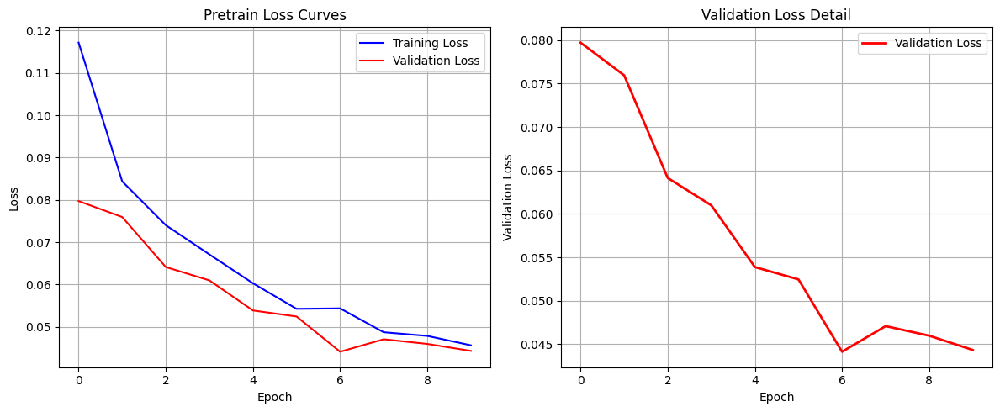

In [22]:
plot_pretrain_losses(train_losses, val_losses)

In [12]:
class GANLoss(nn.Module):
    """GAN Loss"""
    def __init__(self, target_real_label=1.0, target_fake_label=0.0):
        super(GANLoss, self).__init__()
        self.register_buffer('real_label', torch.tensor(target_real_label))
        self.register_buffer('fake_label', torch.tensor(target_fake_label))
        self.loss = nn.MSELoss()
    
    def get_target_tensor(self, prediction, target_is_real):
        if target_is_real:
            target_tensor = self.real_label
        else:
            target_tensor = self.fake_label
        return target_tensor.expand_as(prediction)
    
    def __call__(self, prediction, target_is_real):
        target_tensor = self.get_target_tensor(prediction, target_is_real)
        loss = self.loss(prediction, target_tensor)
        return loss

def train_gan(use_pretrained=True, pretrained_path='pretrained_generator_best.pth'):
    """Hàm huấn luyện GAN với pretrained generator"""
    
    device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
    print(f"=== TRAINING GAN ===")
    print(f"Sử dụng device: {device}")
    print(f"Use pretrained: {use_pretrained}")
    
    # Transforms
    transform = transforms.Compose([
        transforms.Resize((256, 256)),
        transforms.ToTensor(),
        transforms.Normalize([0.5, 0.5, 0.5], [0.5, 0.5, 0.5])
    ])
    
    # Dataset
    dataset = FaceRestorationGANDataset(
        degraded_dir="/kaggle/working/fakefaces_degraded",
        original_dir="/kaggle/input/fakefaces",
        transform=transform
    )
    
    # DataLoader
    train_size = int(0.9 * len(dataset))
    val_size = len(dataset) - train_size
    train_dataset, val_dataset = random_split(dataset, [train_size, val_size])
    
    train_loader = DataLoader(train_dataset, batch_size=4, shuffle=True, num_workers=2)
    val_loader = DataLoader(val_dataset, batch_size=4, shuffle=False, num_workers=2)
    
    # Models
    generator = UNetGenerator().to(device)
    discriminator = PatchGANDiscriminator().to(device)
    
    # Load pretrained generator if available
    if use_pretrained:
        try:
            checkpoint = torch.load(pretrained_path, map_location=device)
            if 'model_state_dict' in checkpoint:
                generator.load_state_dict(checkpoint['model_state_dict'])
                print(f"Loaded pretrained generator from {pretrained_path}")
                if 'val_loss' in checkpoint:
                    print(f"  Pretrained validation loss: {checkpoint['val_loss']:.6f}")
            else:
                generator.load_state_dict(checkpoint)
                print(f"Loaded pretrained generator weights from {pretrained_path}")
        except FileNotFoundError:
            print(f"Pretrained model not found at {pretrained_path}")
            print("  Starting GAN training from scratch...")
        except Exception as e:
            print(f"Error loading pretrained model: {e}")
            print("  Starting GAN training from scratch...")
    
    # Loss functions
    criterion_GAN = GANLoss().to(device)
    criterion_L1 = nn.L1Loss()
    
    # Optimizers với learning rates khác nhau cho GAN training
    optimizer_G = optim.Adam(generator.parameters(), lr=0.0001, betas=(0.5, 0.999))  # Slower for GAN
    optimizer_D = optim.Adam(discriminator.parameters(), lr=0.0002, betas=(0.5, 0.999))
    
    # Schedulers
    scheduler_G = optim.lr_scheduler.StepLR(optimizer_G, step_size=25, gamma=0.5)
    scheduler_D = optim.lr_scheduler.StepLR(optimizer_D, step_size=25, gamma=0.5)
    
    # Training parameters
    num_epochs = 10  # Reduced since we have pretrained generator
    lambda_L1 = 100  # L1 loss weight
    
    # Training history
    g_losses = []
    d_losses = []
    
    print("Bắt đầu GAN training...")
    print(f"Generator learning rate: {optimizer_G.param_groups[0]['lr']}")
    print(f"Discriminator learning rate: {optimizer_D.param_groups[0]['lr']}")
    
    for epoch in range(num_epochs):
        generator.train()
        discriminator.train()
        
        epoch_g_loss = 0
        epoch_d_loss = 0
        
        for batch_idx, (degraded_imgs, original_imgs) in enumerate(train_loader):
            degraded_imgs = degraded_imgs.to(device)
            original_imgs = original_imgs.to(device)
            
            batch_size = degraded_imgs.size(0)
            
            # ==========================================
            # Train Discriminator (every iteration)
            # ==========================================
            optimizer_D.zero_grad()
            
            # Real loss
            pred_real = discriminator(original_imgs, degraded_imgs)
            loss_D_real = criterion_GAN(pred_real, True)
            
            # Fake loss
            with torch.no_grad():
                fake_imgs = generator(degraded_imgs)
            pred_fake = discriminator(fake_imgs.detach(), degraded_imgs)
            loss_D_fake = criterion_GAN(pred_fake, False)
            
            # Total discriminator loss
            loss_D = (loss_D_real + loss_D_fake) * 0.5
            loss_D.backward()
            optimizer_D.step()
            
            # ==========================================
            # Train Generator (every 2 iterations after epoch 10)
            # ==========================================
            train_generator = (epoch < 10) or (batch_idx % 2 == 0)
            
            if train_generator:
                optimizer_G.zero_grad()
                
                # Generate fake images
                fake_imgs = generator(degraded_imgs)
                
                # GAN loss
                pred_fake = discriminator(fake_imgs, degraded_imgs)
                loss_GAN = criterion_GAN(pred_fake, True)
                
                # L1 loss
                loss_L1 = criterion_L1(fake_imgs, original_imgs)
                
                # Total generator loss
                loss_G = loss_GAN + lambda_L1 * loss_L1
                loss_G.backward()
                optimizer_G.step()
                
                epoch_g_loss += loss_G.item()
            
            epoch_d_loss += loss_D.item()
            
            if batch_idx % 500 == 0:
                print(f'Epoch [{epoch+1}/{num_epochs}], Batch [{batch_idx}/{len(train_loader)}]')
                if train_generator:
                    print(f'  Generator Loss: {loss_G.item():.4f} (GAN: {loss_GAN.item():.4f}, L1: {loss_L1.item():.4f})')
                print(f'  Discriminator Loss: {loss_D.item():.4f} (Real: {loss_D_real.item():.4f}, Fake: {loss_D_fake.item():.4f})')
        
        # Update schedulers
        scheduler_G.step()
        scheduler_D.step()
        
        # Average losses
        avg_g_loss = epoch_g_loss / len(train_loader)
        avg_d_loss = epoch_d_loss / len(train_loader)
        g_losses.append(avg_g_loss)
        d_losses.append(avg_d_loss)
        
        print(f'\nEpoch [{epoch+1}/{num_epochs}] Summary:')
        print(f'  G Loss: {avg_g_loss:.4f}, D Loss: {avg_d_loss:.4f}')
        print(f'  G LR: {optimizer_G.param_groups[0]["lr"]:.6f}, D LR: {optimizer_D.param_groups[0]["lr"]:.6f}')
        
        # Validation and save samples
        if (epoch + 1) % 10 == 0:
            print("Running validation...")
            generator.eval()
            val_loss = 0
            with torch.no_grad():
                for degraded_imgs, original_imgs in val_loader:
                    degraded_imgs = degraded_imgs.to(device)
                    original_imgs = original_imgs.to(device)
                    
                    fake_imgs = generator(degraded_imgs)
                    loss = criterion_L1(fake_imgs, original_imgs)
                    val_loss += loss.item()
            
            avg_val_loss = val_loss / len(val_loader)
            print(f'  Validation L1 Loss: {avg_val_loss:.4f}')
            
            # Save checkpoint
            torch.save({
                'epoch': epoch + 1,
                'generator_state_dict': generator.state_dict(),
                'discriminator_state_dict': discriminator.state_dict(),
                'optimizer_G_state_dict': optimizer_G.state_dict(),
                'optimizer_D_state_dict': optimizer_D.state_dict(),
                'g_losses': g_losses,
                'd_losses': d_losses,
                'val_loss': avg_val_loss
            }, f'face_restoration_gan_checkpoint_epoch_{epoch+1}.pth')
            
            # Save sample results
            save_gan_samples(generator, val_loader, epoch + 1, device)
            
        print('-' * 60)
    
    # Save final models
    torch.save(generator.state_dict(), 'face_restoration_generator_final.pth')
    torch.save(discriminator.state_dict(), 'face_restoration_discriminator_final.pth')
    
    print("=== GAN TRAINING HOÀN THÀNH! ===")
    return generator, discriminator, g_losses, d_losses


In [13]:
def save_gan_samples(generator, val_loader, epoch, device, num_samples=3):
    """Lưu ảnh mẫu trong quá trình GAN training"""
    generator.eval()
    
    with torch.no_grad():
        for i, (degraded_imgs, original_imgs) in enumerate(val_loader):
            if i >= 1:  # Chỉ lấy batch đầu tiên
                break
                
            degraded_imgs = degraded_imgs.to(device)
            restored_imgs = generator(degraded_imgs)
            
            # Denormalize cho hiển thị
            degraded_display = (degraded_imgs + 1) / 2.0
            restored_display = (restored_imgs + 1) / 2.0
            original_display = (original_imgs + 1) / 2.0
            
            # Lưu comparison
            for j in range(min(num_samples, degraded_imgs.size(0))):
                fig, axes = plt.subplots(1, 3, figsize=(15, 5))
                
                # Degraded
                img_degraded = degraded_display[j].cpu().permute(1, 2, 0).clamp(0, 1)
                axes[0].imshow(img_degraded)
                axes[0].set_title('Ảnh hỏng')
                axes[0].axis('off')
                
                # Restored (GAN)
                img_restored = restored_display[j].cpu().permute(1, 2, 0).clamp(0, 1)
                axes[1].imshow(img_restored)
                axes[1].set_title(f'GAN Restored (Epoch {epoch})')
                axes[1].axis('off')
                
                # Original
                img_original = original_display[j].cpu().permute(1, 2, 0).clamp(0, 1)
                axes[2].imshow(img_original)
                axes[2].set_title('Ảnh gốc')
                axes[2].axis('off')
                
                plt.tight_layout()
                plt.savefig(f'gan_sample_epoch_{epoch}_img_{j}.png', 
                           dpi=150, bbox_inches='tight')
                plt.close()

In [14]:
generator, discriminator, g_losses, d_losses = train_gan()

=== TRAINING GAN ===
Sử dụng device: cuda
Use pretrained: True
Loaded pretrained generator from pretrained_generator_best.pth
  Pretrained validation loss: 0.044128
Bắt đầu GAN training...
Generator learning rate: 0.0001
Discriminator learning rate: 0.0002
Epoch [1/10], Batch [0/4320]
  Generator Loss: 9.9044 (GAN: 4.1214, L1: 0.0578)
  Discriminator Loss: 0.5849 (Real: 1.0396, Fake: 0.1303)
Epoch [1/10], Batch [500/4320]
  Generator Loss: 5.0087 (GAN: 0.2389, L1: 0.0477)
  Discriminator Loss: 0.2530 (Real: 0.2846, Fake: 0.2215)
Epoch [1/10], Batch [1000/4320]
  Generator Loss: 6.1278 (GAN: 0.2458, L1: 0.0588)
  Discriminator Loss: 0.2576 (Real: 0.2606, Fake: 0.2545)
Epoch [1/10], Batch [1500/4320]
  Generator Loss: 3.9117 (GAN: 0.2472, L1: 0.0366)
  Discriminator Loss: 0.2532 (Real: 0.2803, Fake: 0.2260)
Epoch [1/10], Batch [2000/4320]
  Generator Loss: 6.8633 (GAN: 0.2641, L1: 0.0660)
  Discriminator Loss: 0.2518 (Real: 0.2544, Fake: 0.2492)
Epoch [1/10], Batch [2500/4320]
  Generato

In [15]:
def load_generator(model_path='face_restoration_generator.pth'):
    """Load pre-trained generator"""
    device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
    generator = UNetGenerator().to(device)
    generator.load_state_dict(torch.load(model_path, map_location=device))
    generator.eval()
    return generator

In [16]:
def restore_image_gan(generator, image_path, output_path):
    """Phục chế ảnh sử dụng GAN"""
    device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
    
    # Preprocess
    transform = transforms.Compose([
        transforms.Resize((256, 256)),
        transforms.ToTensor(),
        transforms.Normalize([0.5, 0.5, 0.5], [0.5, 0.5, 0.5])
    ])
    
    # Load image
    image = Image.open(image_path).convert('RGB')
    input_tensor = transform(image).unsqueeze(0).to(device)
    
    # Generate
    with torch.no_grad():
        output_tensor = generator(input_tensor)
    
    # Postprocess
    output_tensor = (output_tensor + 1) / 2.0  # Denormalize
    output_tensor = torch.clamp(output_tensor, 0, 1)
    
    # Convert to PIL Image
    output_img = transforms.ToPILImage()(output_tensor.squeeze(0).cpu())
    output_img.save(output_path)
    
    return output_img

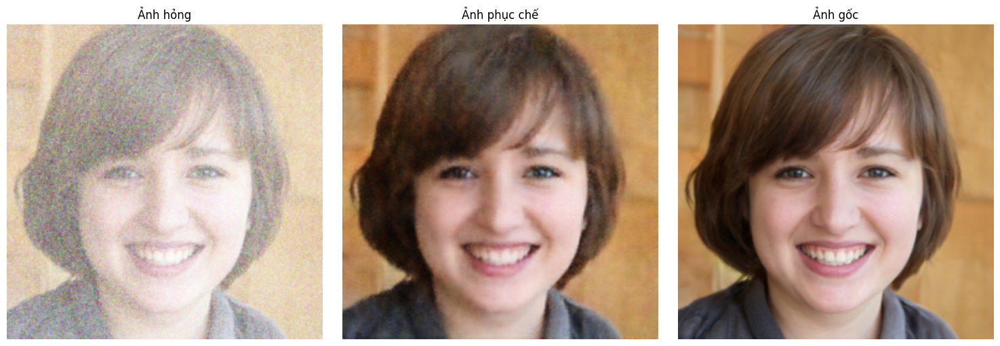

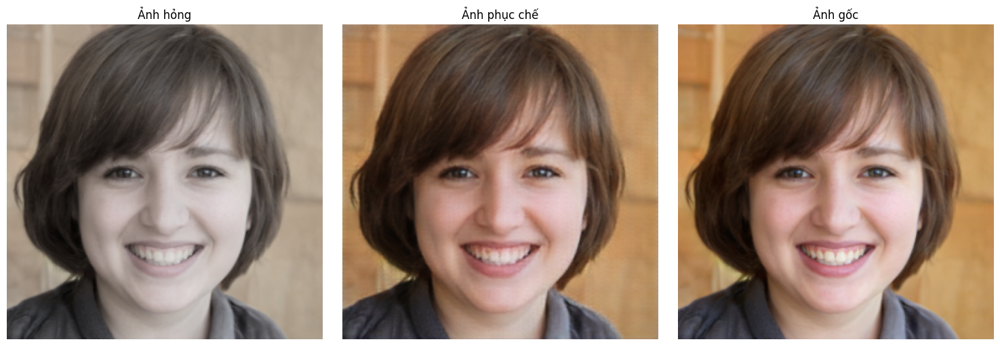

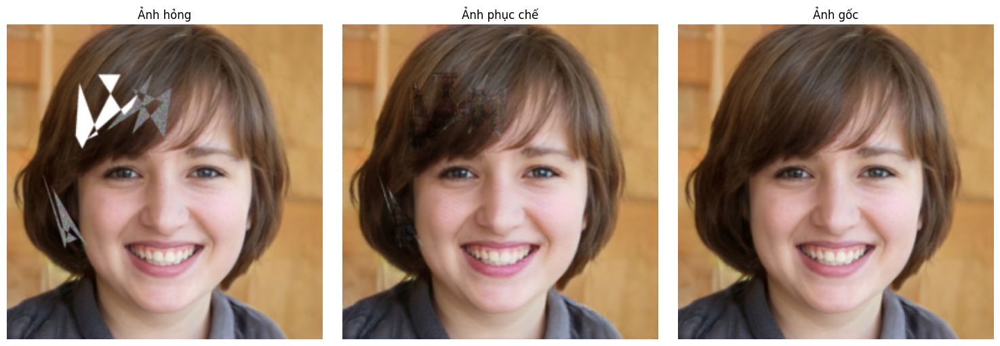

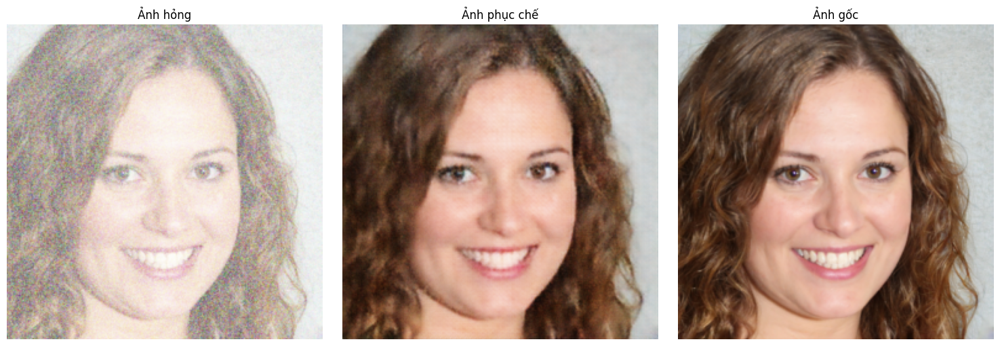

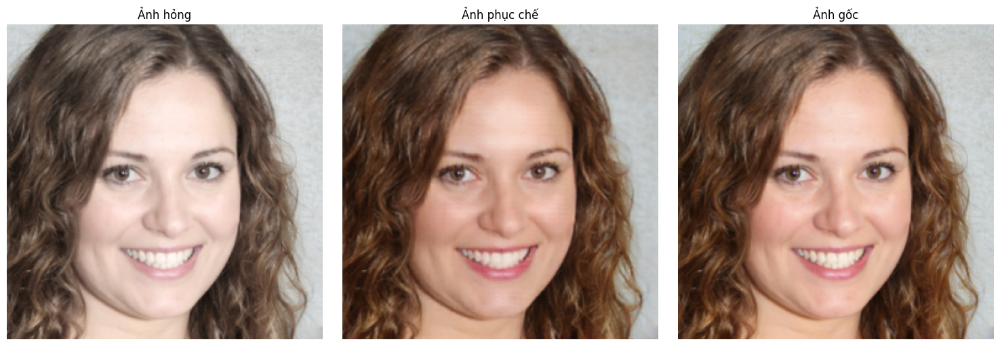

...

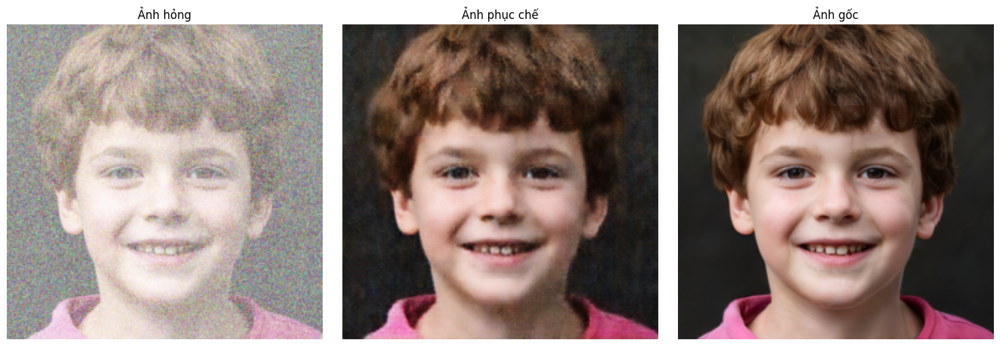

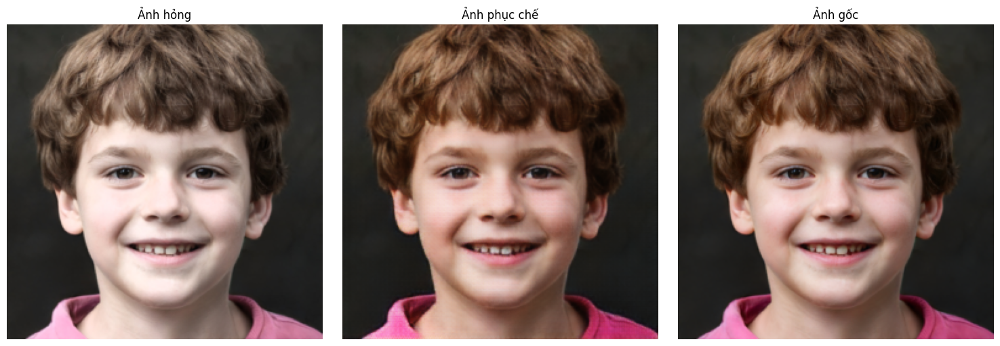

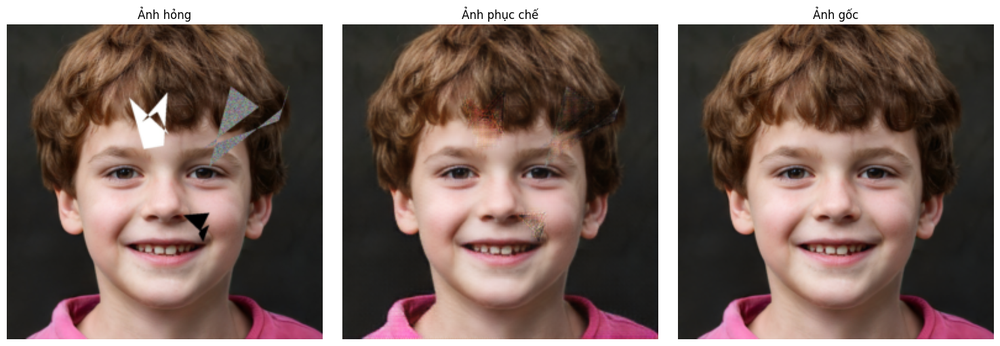

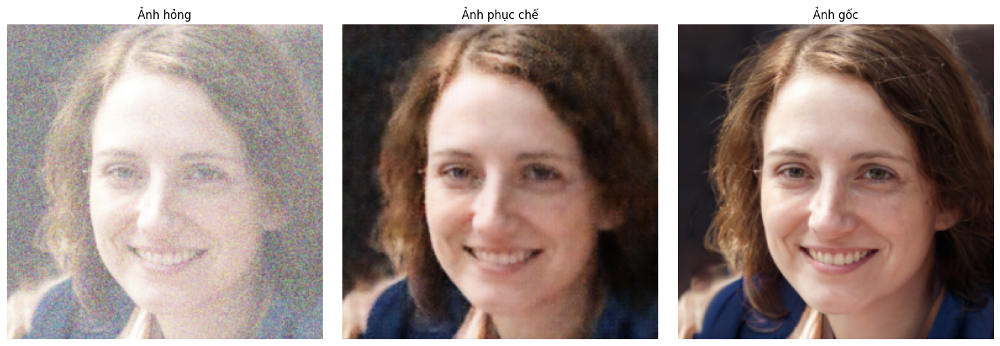

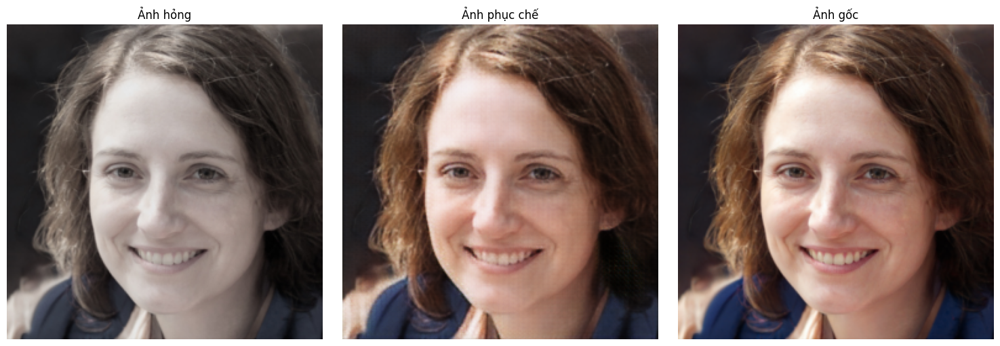

In [24]:
def compare_results(generator, test_loader, num_samples=5):
    """So sánh kết quả before/after"""
    device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
    generator.eval()
    
    with torch.no_grad():
        for i, (degraded_imgs, original_imgs) in enumerate(test_loader):
            if i >= num_samples:
                break
                
            degraded_imgs = degraded_imgs.to(device)
            restored_imgs = generator(degraded_imgs)
            
            # Denormalize for display
            degraded_display = (degraded_imgs + 1) / 2.0
            restored_display = (restored_imgs + 1) / 2.0
            original_display = (original_imgs + 1) / 2.0
            
            # Save comparison
            for j in range(min(4, degraded_imgs.size(0))):
                fig, axes = plt.subplots(1, 3, figsize=(15, 5))
                
                # Degraded
                img_degraded = degraded_display[j].cpu().permute(1, 2, 0)
                axes[0].imshow(img_degraded)
                axes[0].set_title('Ảnh hỏng')
                axes[0].axis('off')
                
                # Restored
                img_restored = restored_display[j].cpu().permute(1, 2, 0)
                axes[1].imshow(img_restored)
                axes[1].set_title('Ảnh phục chế')
                axes[1].axis('off')
                
                # Original
                img_original = original_display[j].cpu().permute(1, 2, 0)
                axes[2].imshow(img_original)
                axes[2].set_title('Ảnh gốc')
                axes[2].axis('off')
                
                plt.tight_layout()
                plt.savefig(f'comparison_batch_{i}_sample_{j}.png', dpi=150, bbox_inches='tight')
                plt.show()

# Tạo DataLoader cho tập kiểm tra
transform = transforms.Compose([
    transforms.Resize((256, 256)),
    transforms.ToTensor(),
    transforms.Normalize([0.5, 0.5, 0.5], [0.5, 0.5, 0.5])
])
test_dataset = FaceRestorationGANDataset(
    degraded_dir="/kaggle/working/fakefaces_degraded",
    original_dir="/kaggle/input/fakefaces",
    transform=transform
)
test_loader = DataLoader(test_dataset, batch_size=4, shuffle=False, num_workers=2)
compare_results(generator, test_loader)